In [1]:
import numpy as np
import torch 
from torch import optim
from torchvision import transforms
from torchvision.models import vgg19

from PIL import Image
from io import BytesIO
from matplotlib import pyplot as plt
import requests

In [2]:
# get the "features" portion of VGG19 (we will not need the "classifier" portion)
vgg = vgg19(pretrained=True).features[:29]

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

In [3]:
# freeze all VGG parameters since we're only optimizing the target image
for param in vgg.parameters():
    param.requires_grad_(False)

In [4]:
# move the model to GPU, if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
vgg.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [5]:
# In the paper, if we take more than 500 x 500 size it would take more than a hours. 

def load_image(img_path, max_size = 612, shape = None):
    ''' Load in and transform an image, making sure the image
    is <= 400 pixels in the x-y dims.'''
    if 'http' in img_path:
        response = requests.get(img_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
        
    else:
        image = Image.open(img_path).convert('RGB')
        
    # Load images will be slow down processing
    
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
        
    if shape is not None:
        size = shape


    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.485, 0.456, 0.406), 
                                             (0.229, 0.224, 0.225))])
    
    # discard the transparent, alpha channel (that's the :3) and add the batch dimension
    image = in_transform(image)[:3, :, :].unsqueeze(0)
    
    return image
    

In [6]:
# Load in content and style image
content = load_image('../input/imagedataset/chicago.jpg').to(device)
# Resize the style to match content, make code easier
style = load_image('../input/imagedataset/painting.jpg', shape = content.shape[-2:]).to(device)

In [7]:
# helper function for un-normalizing an image 
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

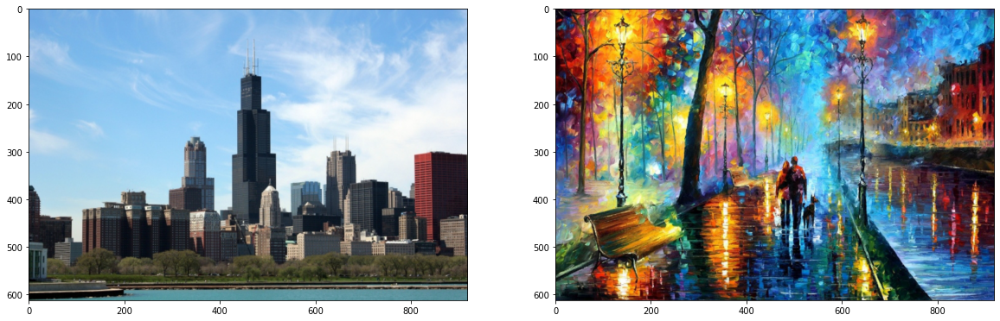

In [8]:
# display the images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
# content and style ims side-by-side
ax1.imshow(im_convert(content))
ax2.imshow(im_convert(style))

In [9]:
def get_features(image, model, layers=None):
    """ Run an image forward through a model and get the features for 
        a set of layers. Default layers are for VGGNet matching Gatys et al (2016)
    """
    
    ## TODO: Complete mapping layer names of PyTorch's VGGNet to names from the paper
    ## Need the layers for the content and style representations of an image
    if layers is None:
        layers = {'0': 'conv1_1', 
                  '5': 'conv2_1', 
                  '10': 'conv3_1',
                  '19': 'conv4_1',
                  '21': 'conv4_2',
                  '28': 'conv5_1'}  ## content representation
        
        
    ## -- do not need to change the code below this line -- ##
    features = {}
    x = image
    # model._modules is a dictionary holding each module in the model
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features

In [10]:
def gram_matrix(tensor):
    """ Calculate the Gram Matrix of a given tensor 
        Gram Matrix: https://en.wikipedia.org/wiki/Gramian_matrix
    """
    
    ## get the batch_size, depth, height, and width of the Tensor
    mat = tensor.view(tensor.shape[0] * tensor.shape[1], -1)
    gram = torch.mm(mat, mat.T)
    
    
    # Official Solution
    # get the batch_size, depth, height, and width of the Tensor
#     b, d, h, w = tensor.size()
    
#     # reshape so we're multiplying the features for each channel
#     tensor = tensor.view(b * d, h * w)
    
#     # calculate the gram matrix
#     gram = torch.mm(tensor, tensor.t())
    
    return gram 

In [11]:
# get content and style features only once before forming the target image
content_features = get_features(content, vgg)
style_features = get_features(style, vgg)

# calculate the gram matrices for each layer of our style representation
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

# create a third "target" image and prep it for change
# it is a good idea to start off with the target as a copy of our *content* image
# then iteratively change its style
target = content.clone().requires_grad_(True).to(device)

In [12]:
# weights for each style layer 
# weighting earlier layers more will result in *larger* style artifacts
# notice we are excluding `conv4_2` our content representation
style_weights = {'conv1_1': 1.,
                 'conv2_1': 0.8,
                 'conv3_1': 0.5,
                 'conv4_1': 0.3,
                 'conv5_1': 0.1}

# you may choose to leave these as is
content_weight = 1  # alpha
style_weight = 0.01  # beta

Total loss: 2.4657540321350098 
Steps: 400


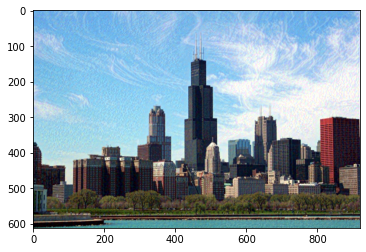

Total loss: 1.8316611051559448 
Steps: 800


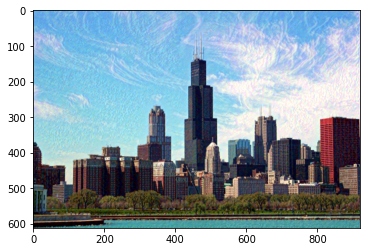

Total loss: 1.5204544067382812 
Steps: 1200


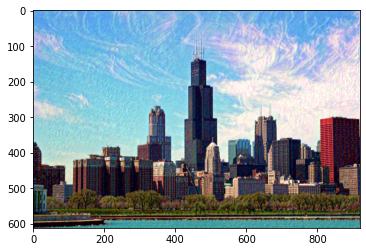

Total loss: 1.3231916427612305 
Steps: 1600


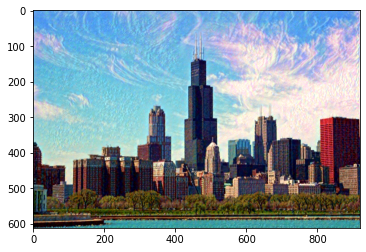

Total loss: 1.18380868434906 
Steps: 2000


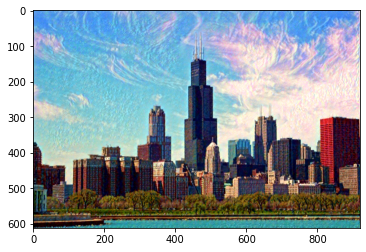

Total loss: 1.080871343612671 
Steps: 2400


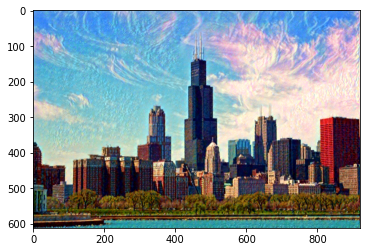

Total loss: 1.0051724910736084 
Steps: 2800


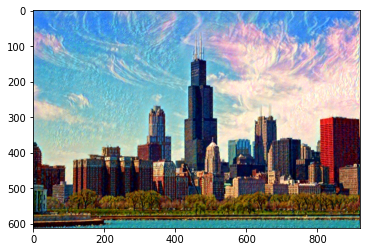

Total loss: 0.9495010375976562 
Steps: 3200


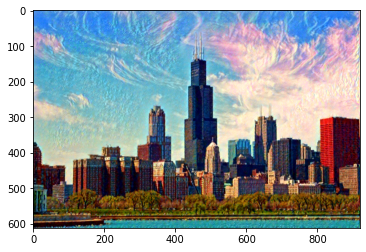

Total loss: 0.9079830646514893 
Steps: 3600


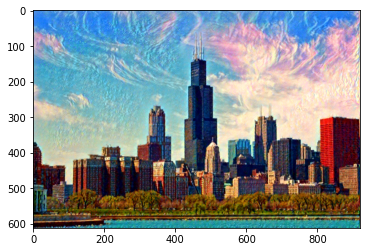

Total loss: 0.8765689134597778 
Steps: 4000


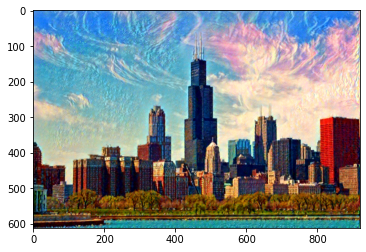

Total loss: 0.8522937297821045 
Steps: 4400


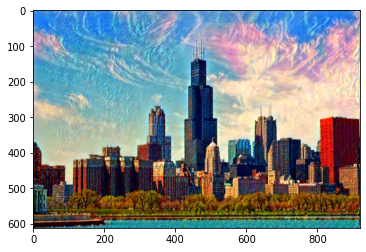

Total loss: 0.8331006765365601 
Steps: 4800


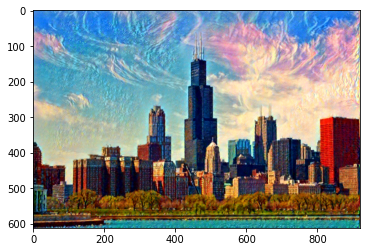

Total loss: 0.8176379203796387 
Steps: 5200


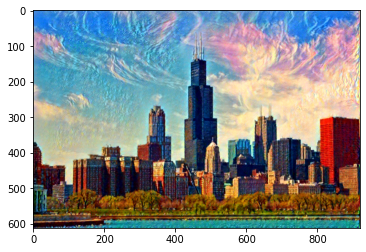

Total loss: 0.8050320744514465 
Steps: 5600


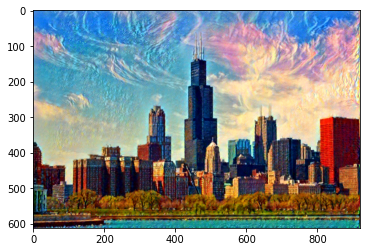

Total loss: 0.7945572733879089 
Steps: 6000


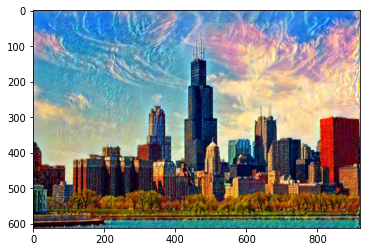

Total loss: 0.7856842279434204 
Steps: 6400


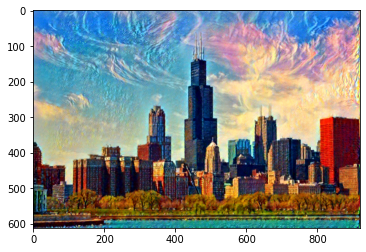

Total loss: 0.7782484292984009 
Steps: 6800


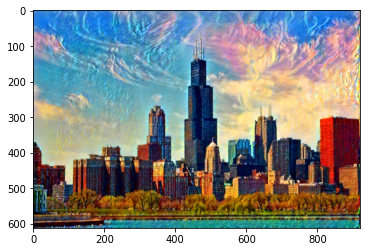

Total loss: 0.7719428539276123 
Steps: 7200


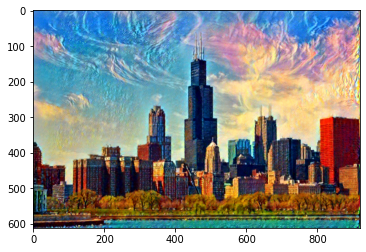

Total loss: 0.7665979862213135 
Steps: 7600


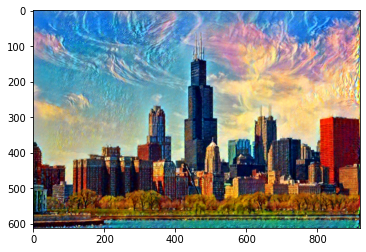

Total loss: 0.761965274810791 
Steps: 8000


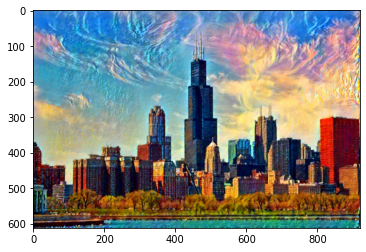

Total loss: 0.7579888105392456 
Steps: 8400


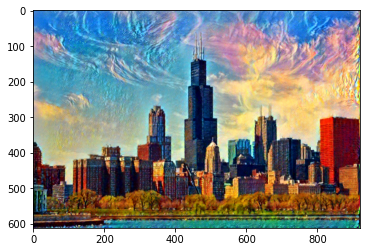

Total loss: 0.7545011043548584 
Steps: 8800


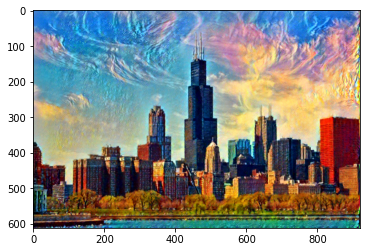

Total loss: 0.7514444589614868 
Steps: 9200


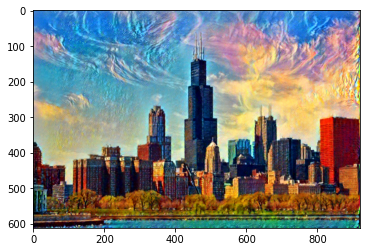

Total loss: 0.7487397193908691 
Steps: 9600


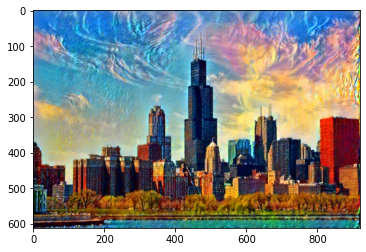

Total loss: 0.7463244199752808 
Steps: 10000


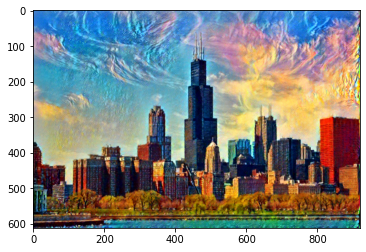

Total loss: 0.74411940574646 
Steps: 10400


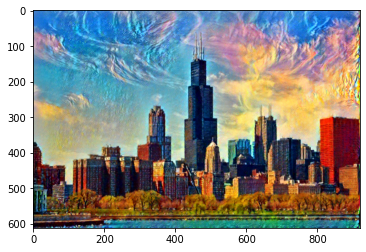

Total loss: 0.7421238422393799 
Steps: 10800


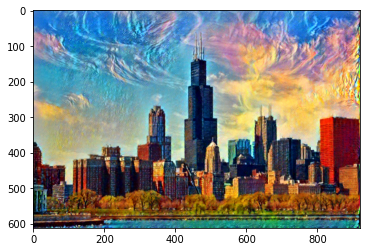

Total loss: 0.7403161525726318 
Steps: 11200


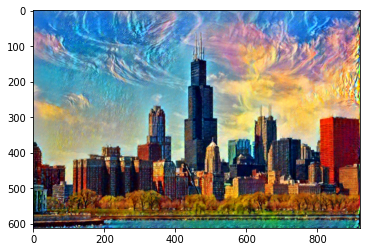

Total loss: 0.7386510372161865 
Steps: 11600


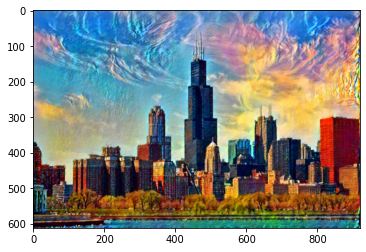

Total loss: 0.7371313571929932 
Steps: 12000


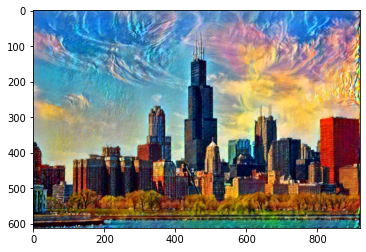

Total loss: 0.735741138458252 
Steps: 12400


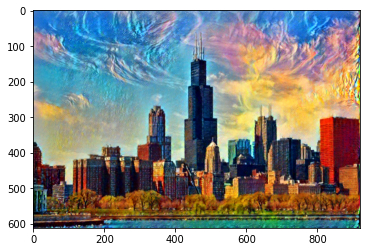

Total loss: 0.7344497442245483 
Steps: 12800


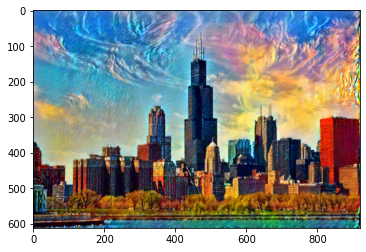

Total loss: 0.7332431077957153 
Steps: 13200


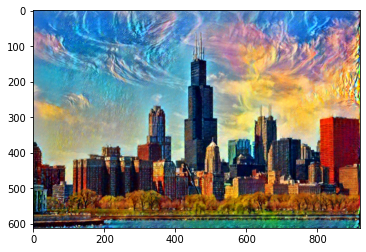

Total loss: 0.7321158647537231 
Steps: 13600


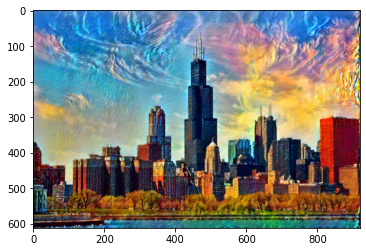

Total loss: 0.731047511100769 
Steps: 14000


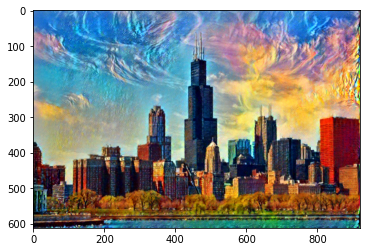

Total loss: 0.7300329208374023 
Steps: 14400


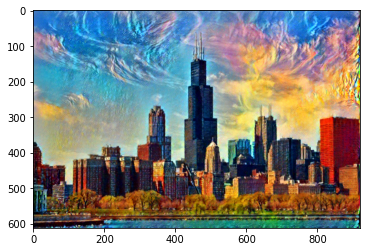

Total loss: 0.7290855646133423 
Steps: 14800


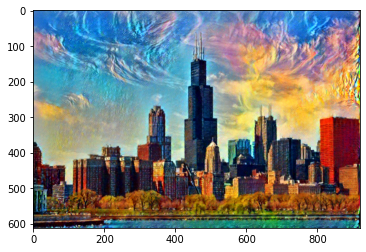

Total loss: 0.7281851768493652 
Steps: 15200


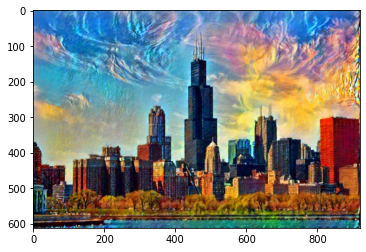

Total loss: 0.7273205518722534 
Steps: 15600


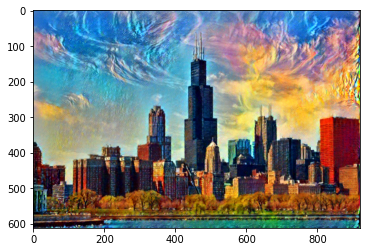

Total loss: 0.7265063524246216 
Steps: 16000


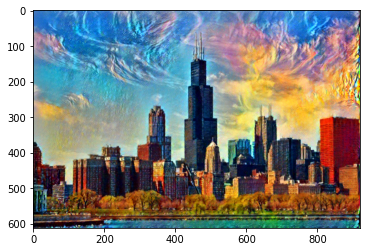

Total loss: 0.7257493734359741 
Steps: 16400


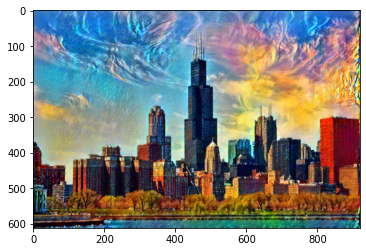

Total loss: 0.7250301837921143 
Steps: 16800


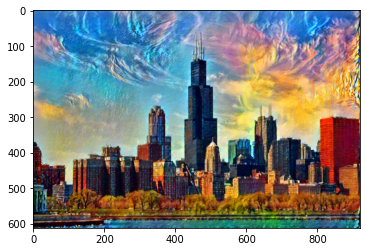

Total loss: 0.7243613004684448 
Steps: 17200


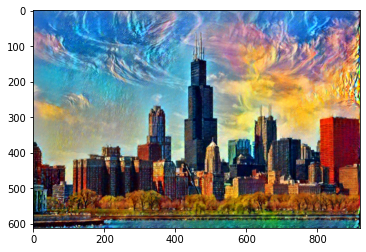

Total loss: 0.7237321138381958 
Steps: 17600


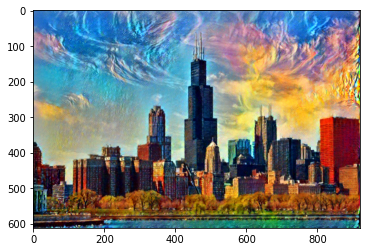

Total loss: 0.7231290936470032 
Steps: 18000


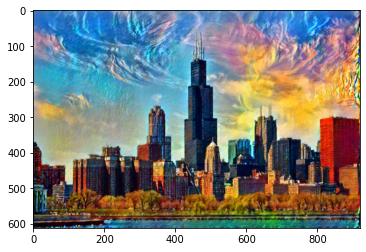

Total loss: 0.7225574254989624 
Steps: 18400


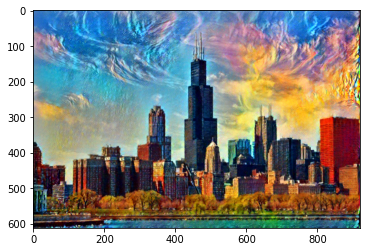

Total loss: 0.7220139503479004 
Steps: 18800


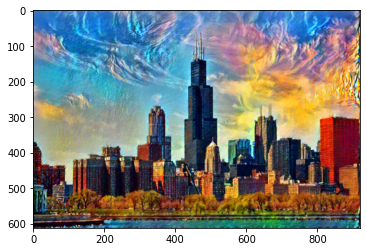

Total loss: 0.721493124961853 
Steps: 19200


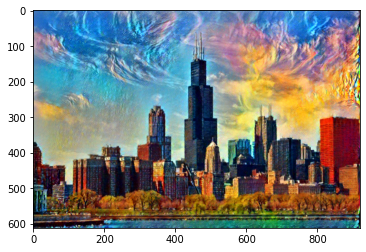

Total loss: 0.7210030555725098 
Steps: 19600


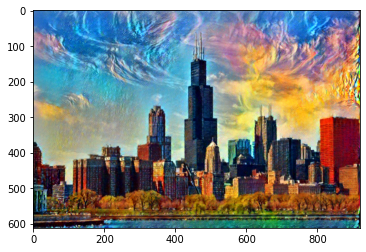

Total loss: 0.7205291986465454 
Steps: 20000


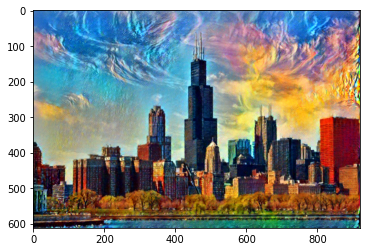

Total loss: 0.7200701832771301 
Steps: 20400


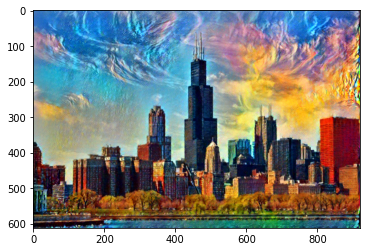

Total loss: 0.7196188569068909 
Steps: 20800


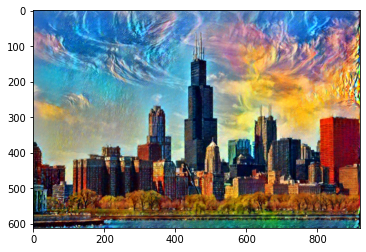

Total loss: 0.7191816568374634 
Steps: 21200


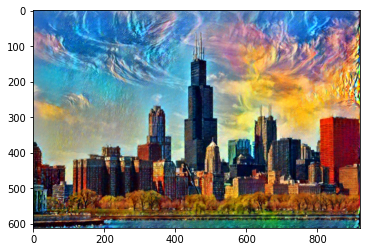

Total loss: 0.7187433242797852 
Steps: 21600


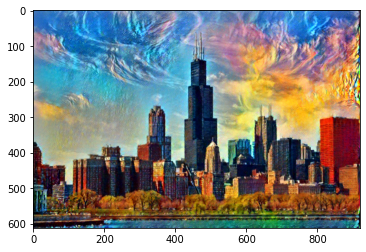

Total loss: 0.7183166742324829 
Steps: 22000


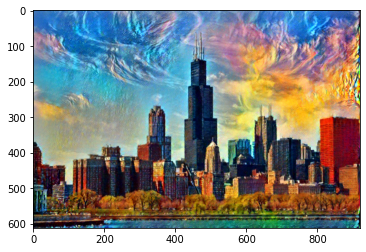

Total loss: 0.7179261445999146 
Steps: 22400


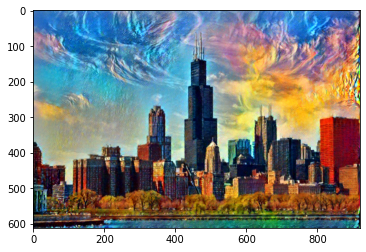

Total loss: 0.7175368666648865 
Steps: 22800


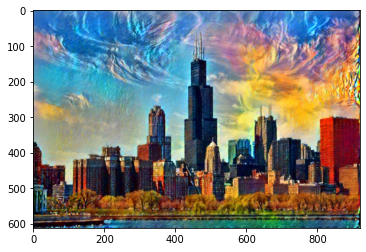

Total loss: 0.7171775102615356 
Steps: 23200


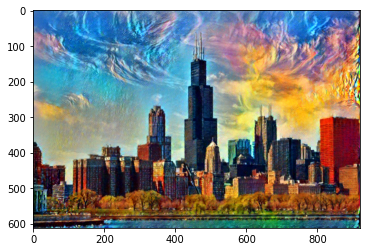

Total loss: 0.7168376445770264 
Steps: 23600


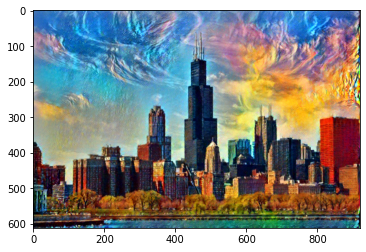

Total loss: 0.7165241241455078 
Steps: 24000


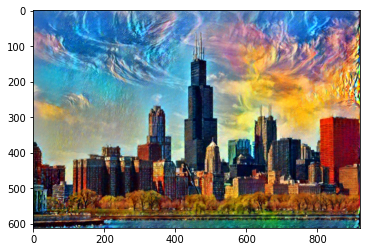

Total loss: 0.7162220478057861 
Steps: 24400


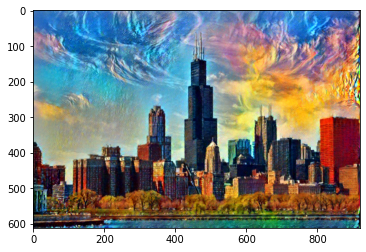

Total loss: 0.7159174680709839 
Steps: 24800


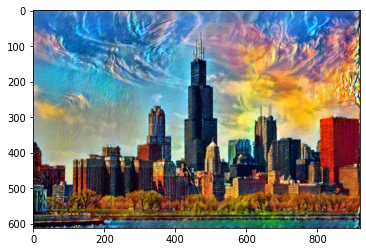

Total loss: 0.7156234979629517 
Steps: 25200


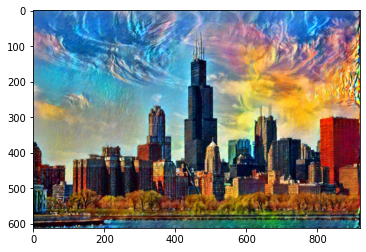

Total loss: 0.715332567691803 
Steps: 25600


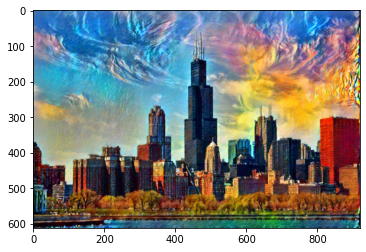

Total loss: 0.7150546312332153 
Steps: 26000


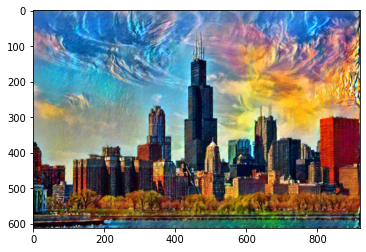

Total loss: 0.7147876024246216 
Steps: 26400


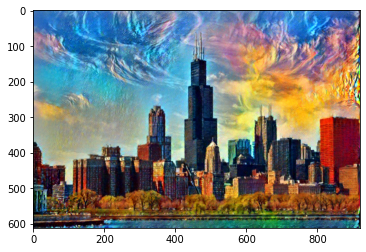

Total loss: 0.7145403623580933 
Steps: 26800


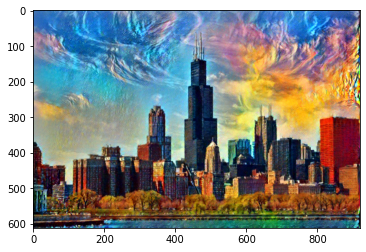

Total loss: 0.714281439781189 
Steps: 27200


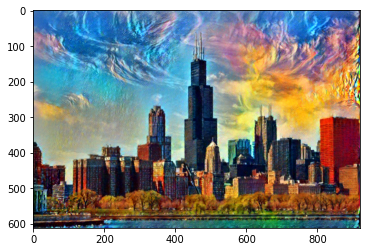

Total loss: 0.714037299156189 
Steps: 27600


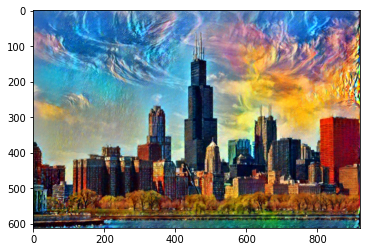

Total loss: 0.7138043642044067 
Steps: 28000


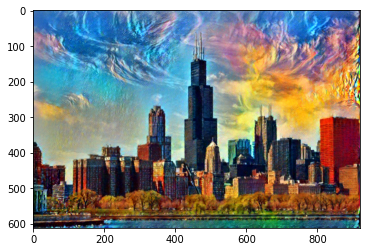

Total loss: 0.7135727405548096 
Steps: 28400


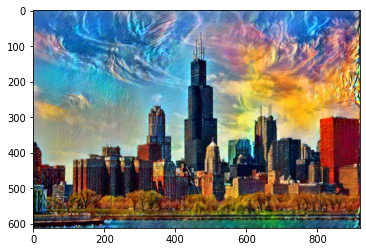

Total loss: 0.7133445143699646 
Steps: 28800


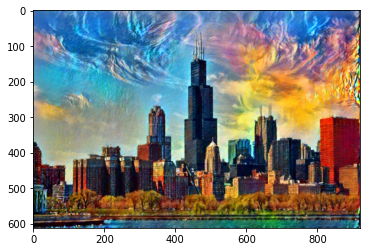

Total loss: 0.7131216526031494 
Steps: 29200


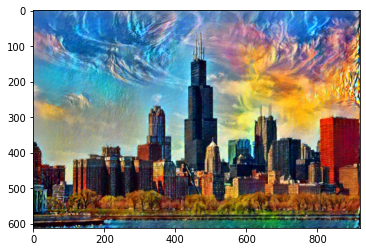

Total loss: 0.7129091024398804 
Steps: 29600


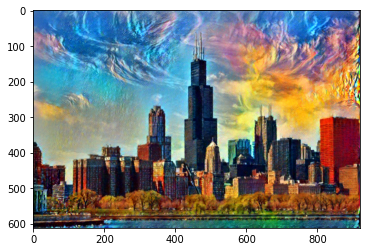

Total loss: 0.7126990556716919 
Steps: 30000


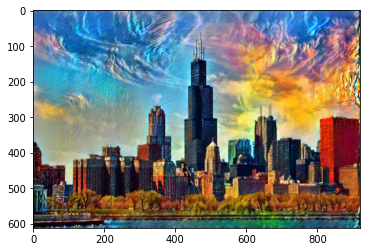

Total loss: 0.7125018239021301 
Steps: 30400


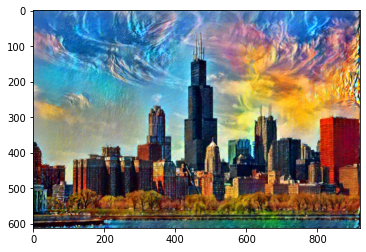

Total loss: 0.7123010754585266 
Steps: 30800


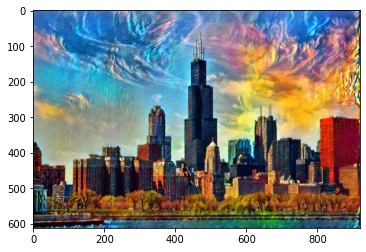

Total loss: 0.7121099233627319 
Steps: 31200


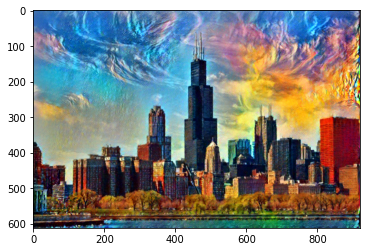

Total loss: 0.7119216918945312 
Steps: 31600


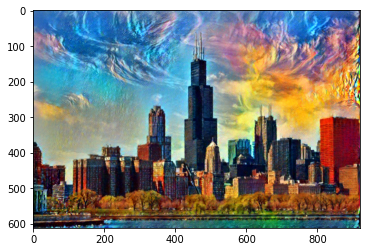

Total loss: 0.7117149233818054 
Steps: 32000


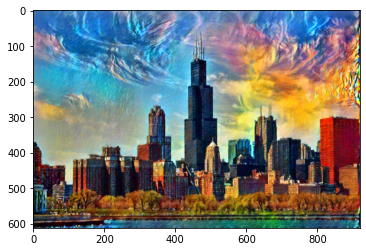

Total loss: 0.7115275859832764 
Steps: 32400


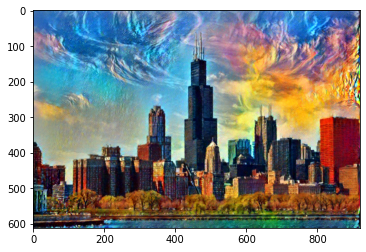

Total loss: 0.7113453149795532 
Steps: 32800


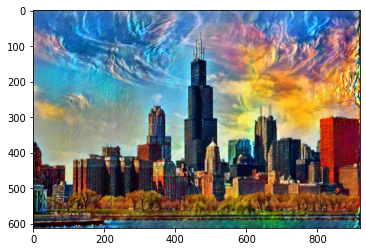

Total loss: 0.711162805557251 
Steps: 33200


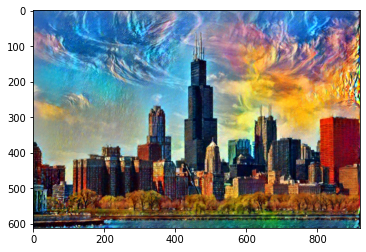

Total loss: 0.7109967470169067 
Steps: 33600


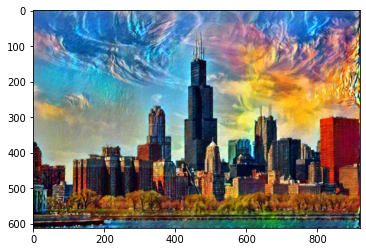

Total loss: 0.7108297944068909 
Steps: 34000


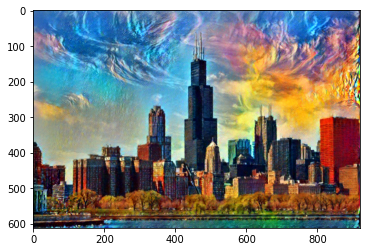

Total loss: 0.7106674909591675 
Steps: 34400


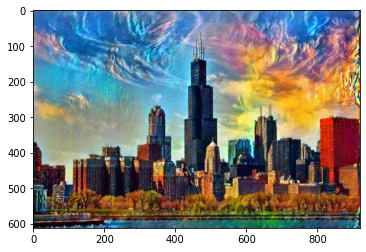

Total loss: 0.7104978561401367 
Steps: 34800


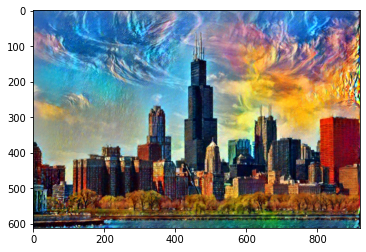

Total loss: 0.7103406190872192 
Steps: 35200


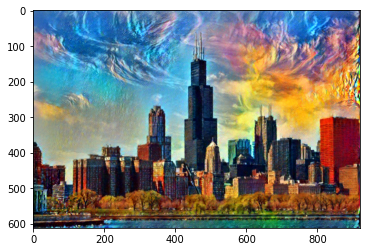

Total loss: 0.7101897597312927 
Steps: 35600


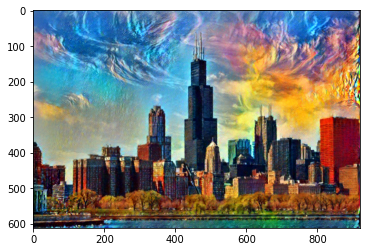

Total loss: 0.7100428342819214 
Steps: 36000


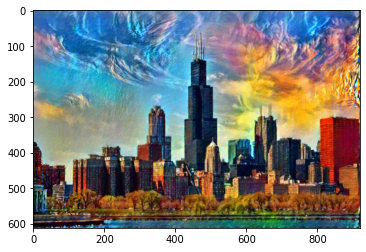

Total loss: 0.7098952531814575 
Steps: 36400


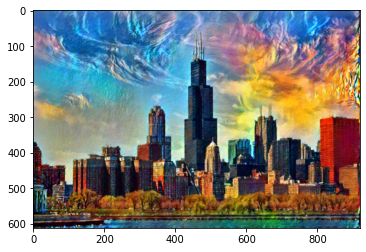

Total loss: 0.7097541093826294 
Steps: 36800


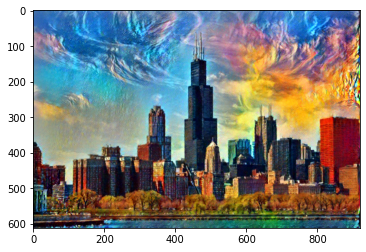

Total loss: 0.709613025188446 
Steps: 37200


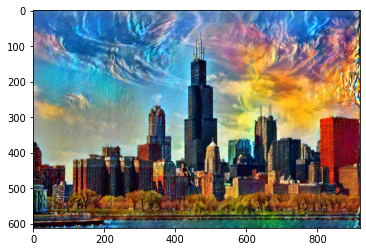

Total loss: 0.7094871997833252 
Steps: 37600


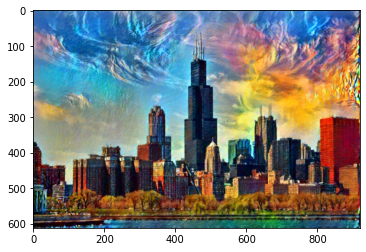

Total loss: 0.709355890750885 
Steps: 38000


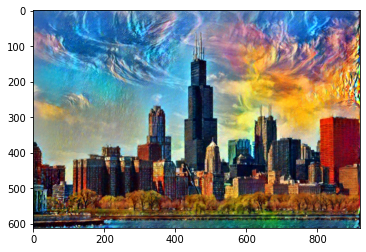

Total loss: 0.7092307806015015 
Steps: 38400


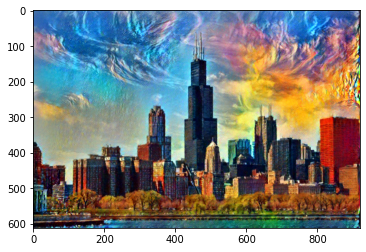

Total loss: 0.7091022729873657 
Steps: 38800


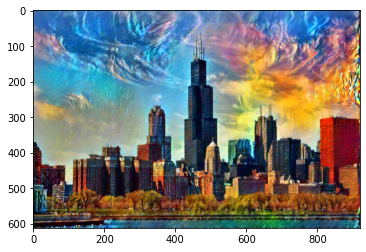

Total loss: 0.7089800834655762 
Steps: 39200


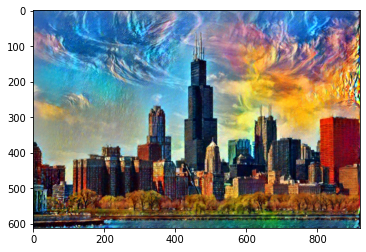

Total loss: 0.708854079246521 
Steps: 39600


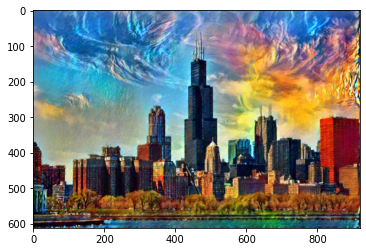

Total loss: 0.7087320685386658 
Steps: 40000


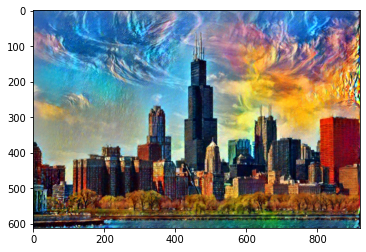

Total loss: 0.7086101770401001 
Steps: 40400


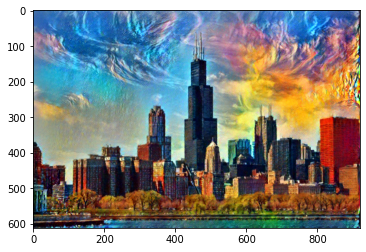

Total loss: 0.7084944248199463 
Steps: 40800


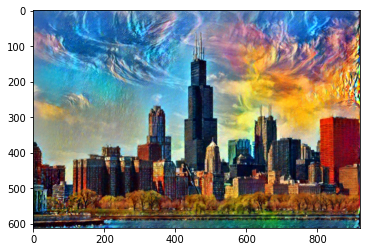

Total loss: 0.7083855867385864 
Steps: 41200


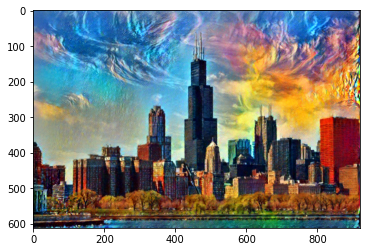

Total loss: 0.7082778215408325 
Steps: 41600


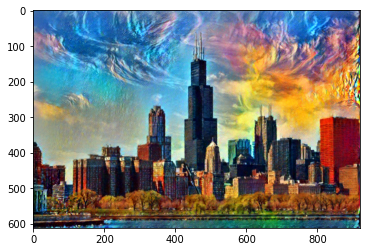

Total loss: 0.7081748247146606 
Steps: 42000


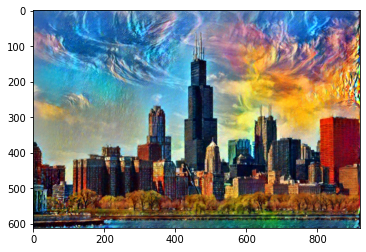

Total loss: 0.7080634832382202 
Steps: 42400


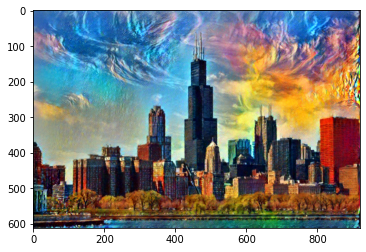

Total loss: 0.7079648971557617 
Steps: 42800


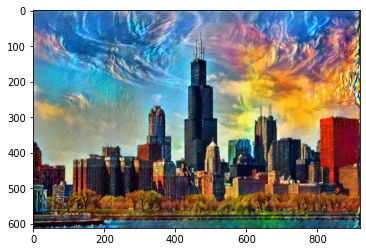

Total loss: 0.7078618407249451 
Steps: 43200


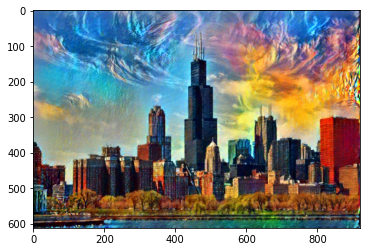

Total loss: 0.7077616453170776 
Steps: 43600


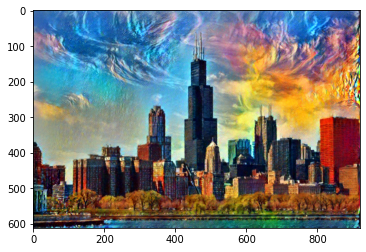

Total loss: 0.7076642513275146 
Steps: 44000


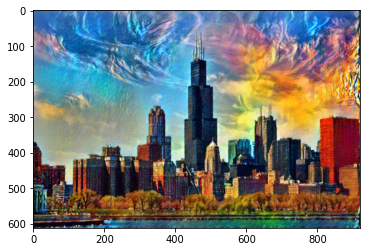

Total loss: 0.7075662612915039 
Steps: 44400


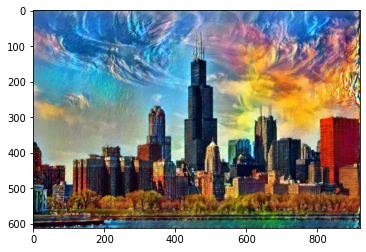

Total loss: 0.7074647545814514 
Steps: 44800


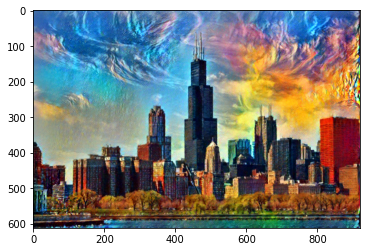

Total loss: 0.7073699235916138 
Steps: 45200


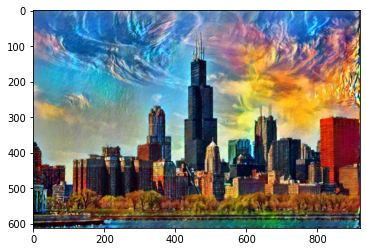

Total loss: 0.7072754502296448 
Steps: 45600


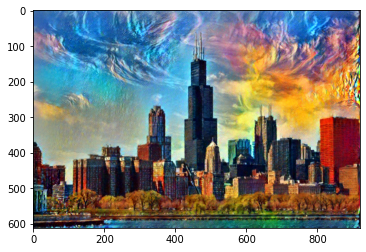

Total loss: 0.707183837890625 
Steps: 46000


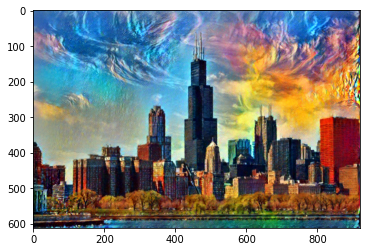

Total loss: 0.7070959806442261 
Steps: 46400


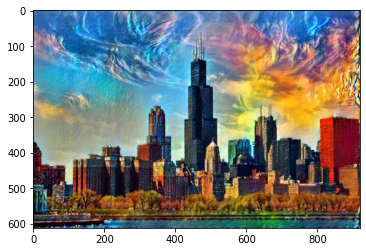

Total loss: 0.7070099711418152 
Steps: 46800


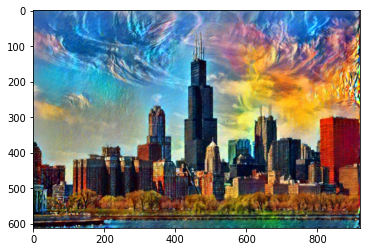

Total loss: 0.7069281339645386 
Steps: 47200


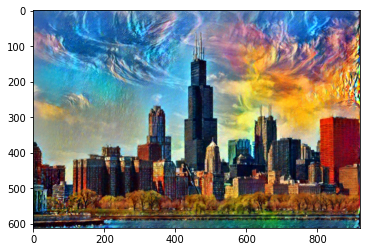

Total loss: 0.7068430185317993 
Steps: 47600


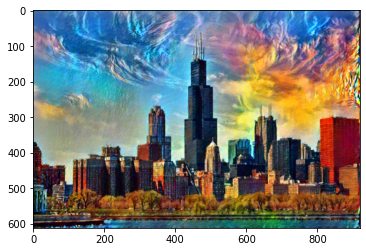

Total loss: 0.7067621946334839 
Steps: 48000


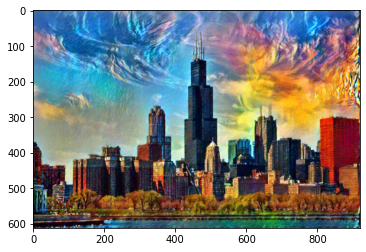

Total loss: 0.7066847085952759 
Steps: 48400


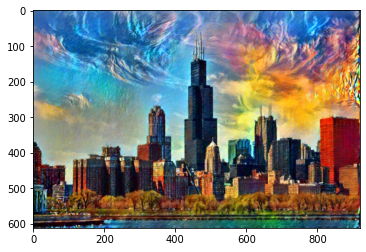

Total loss: 0.7066053748130798 
Steps: 48800


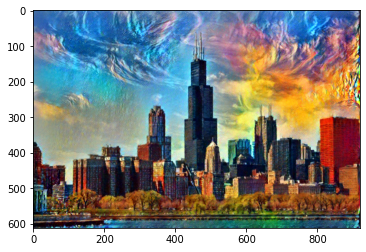

Total loss: 0.7065266966819763 
Steps: 49200


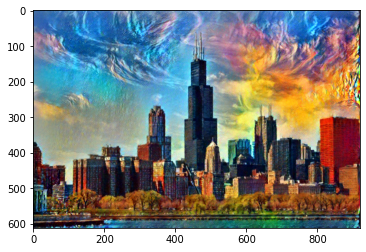

Total loss: 0.7064514756202698 
Steps: 49600


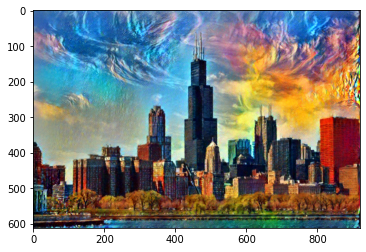

Total loss: 0.7063742280006409 
Steps: 50000


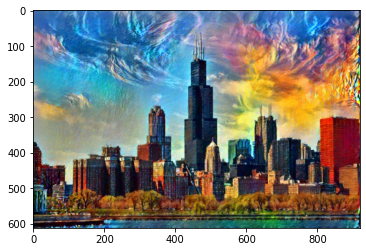

Total loss: 0.7063038349151611 
Steps: 50400


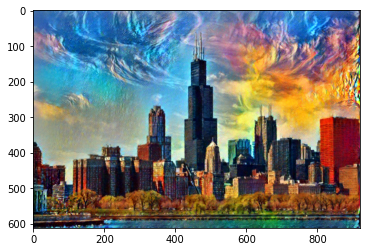

Total loss: 0.706228494644165 
Steps: 50800


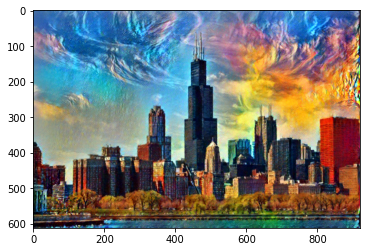

Total loss: 0.7061551809310913 
Steps: 51200


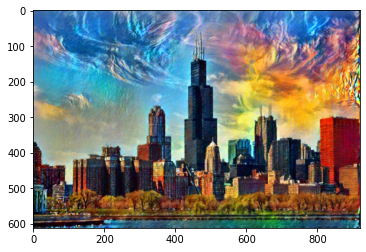

Total loss: 0.7060873508453369 
Steps: 51600


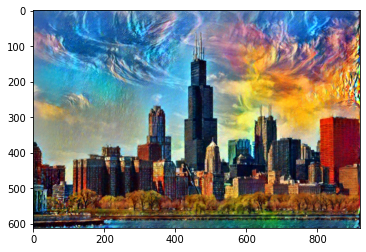

Total loss: 0.7060184478759766 
Steps: 52000


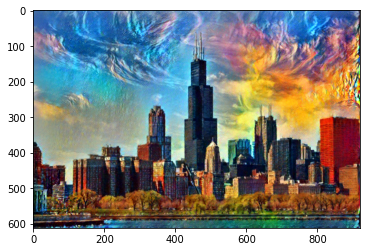

Total loss: 0.7059467434883118 
Steps: 52400


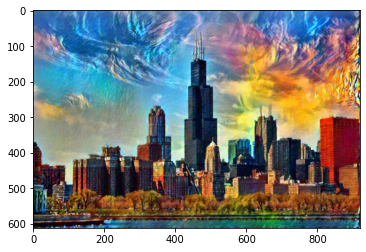

Total loss: 0.7058776617050171 
Steps: 52800


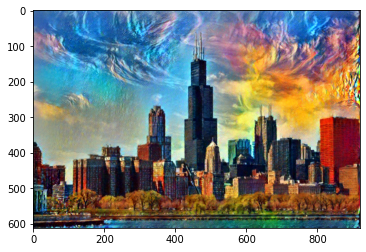

Total loss: 0.7058153748512268 
Steps: 53200


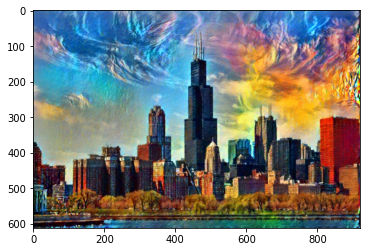

Total loss: 0.7057474851608276 
Steps: 53600


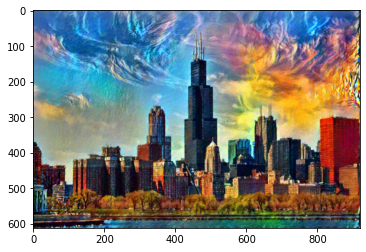

Total loss: 0.7056800127029419 
Steps: 54000


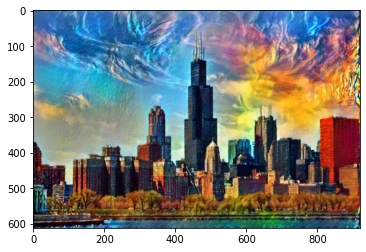

Total loss: 0.7056195735931396 
Steps: 54400


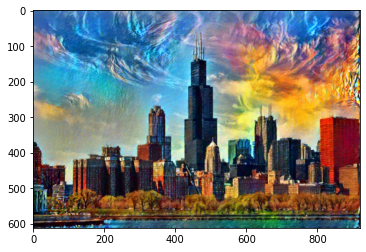

Total loss: 0.7055619955062866 
Steps: 54800


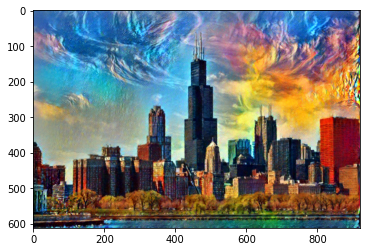

Total loss: 0.7055006623268127 
Steps: 55200


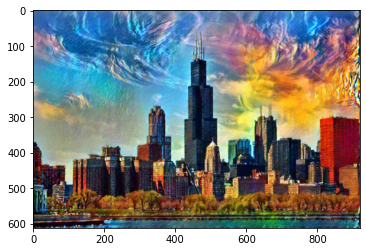

Total loss: 0.705439567565918 
Steps: 55600


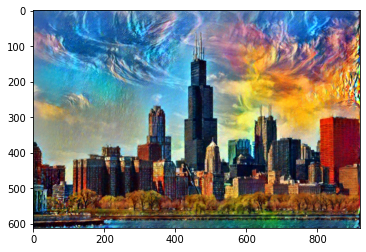

Total loss: 0.7053824663162231 
Steps: 56000


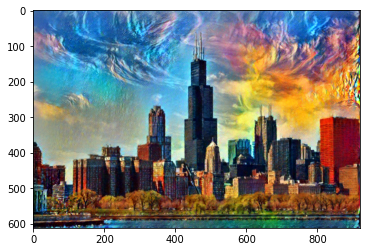

Total loss: 0.7053216099739075 
Steps: 56400


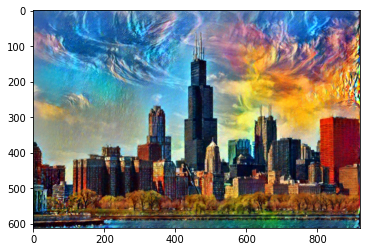

Total loss: 0.7052544355392456 
Steps: 56800


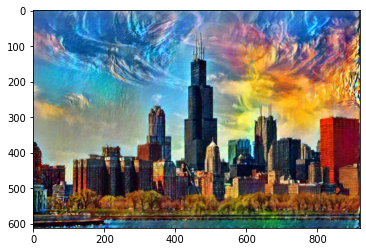

Total loss: 0.7051995396614075 
Steps: 57200


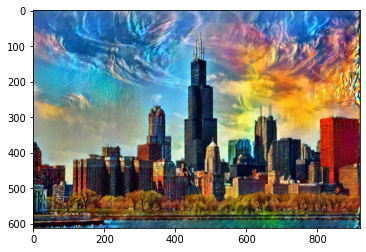

Total loss: 0.7051359415054321 
Steps: 57600


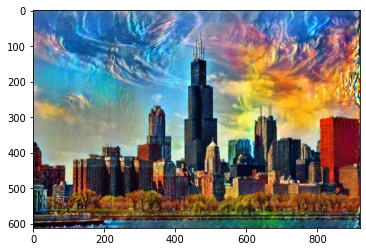

Total loss: 0.7050744295120239 
Steps: 58000


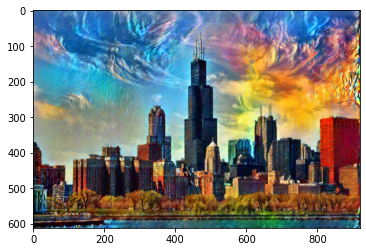

Total loss: 0.7050175666809082 
Steps: 58400


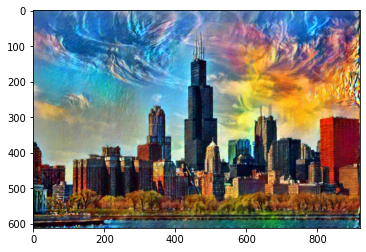

Total loss: 0.7049589157104492 
Steps: 58800


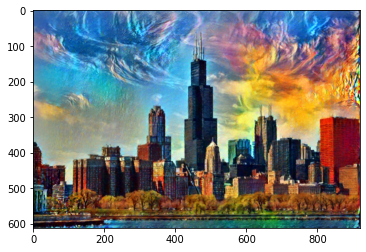

Total loss: 0.704908013343811 
Steps: 59200


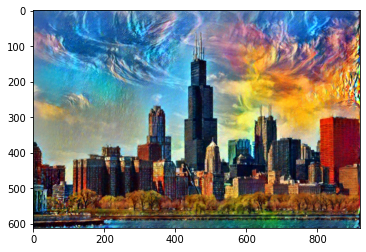

Total loss: 0.7048481702804565 
Steps: 59600


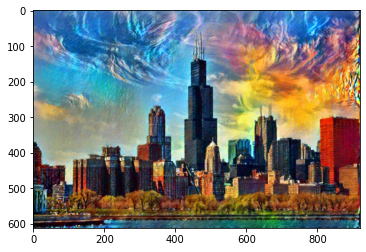

Total loss: 0.7047879695892334 
Steps: 60000


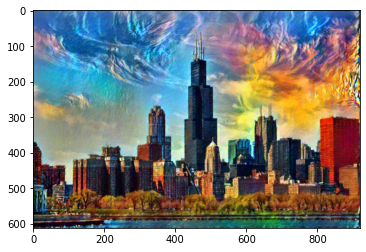

In [13]:
# for displaying the target image, intermittently
show_every = 400

# iteration hyperparameters
optimizer = optim.Adam([target], lr=0.001)
steps = 60000  # decide how many iterations to update your image (5000)

for ii in range(1, steps+1):
    
    ## TODO: get the features from your target image    
    ## Then calculate the content loss
    target_features = get_features(target, vgg)
    content_loss = torch.mean((target_features['conv4_2'] - content_features['conv4_2'])**2)
    
    # the style loss
    # initialize the style loss to 0
    style_loss = 0
    # iterate through each style layer and add to the style loss
    for layer in style_weights:
        # get the "target" style representation for the layer
        target_feature = target_features[layer]
        _, d, h, w = target_feature.shape
        
        ## TODO: Calculate the target gram matrix
        target_gram = gram_matrix(target_feature)
        
        ## TODO:  get the "style" style representation
        style_gram = style_grams[layer]
        ## TODO: Calculate the style loss for one layer, weighted appropriately
        layer_style_loss = style_weights[layer] * torch.mean((target_gram - style_gram)**2)
        
        # add to the style loss
        style_loss += layer_style_loss / (d * h * w)
        
        
    ## TODO:  calculate the *total* loss
    total_loss = content_weight * content_loss + style_weight * style_loss 
    
    ## -- do not need to change code, below -- ##
    # update your target image
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()
    
    # display intermediate images and print the loss
    if  ii % show_every == 0:
        print('Total loss: {} \nSteps: {}'.format(total_loss.item(), ii))
        plt.imshow(im_convert(target))
        plt.show()